# Reference: 
https://medium.com/@chongdashu/papers-decoded-imagic-text-based-real-image-editing-with-diffusion-models-b1bda8b2532a

In [1]:
import inspect

from pathlib import Path

import numpy as np
import torch
from accelerate import Accelerator
from diffusers import (
    AutoencoderKL,
    UNet2DConditionModel,
    DDIMScheduler,
    EulerDiscreteScheduler
)
# from huggingface_hub import notebook_login
from PIL import Image
from torchvision import transforms as tfms
from tqdm.auto import tqdm
from transformers import CLIPTextModel, CLIPTokenizer
from typing import Optional

In [2]:
# Set seed
torch.manual_seed(0)

# (From the paper) VAE scale term to get closer to unit variance
vae_magic = 0.18215

# Load the autoencoder model which will be used to decode the latents into image space.
# sd_path = "stabilityai/stable-diffusion-2-1"
# clip_path = "laion/CLIP-ViT-H-14-laion2B-s32B-b79K"
sd_path = "runwayml/stable-diffusion-v1-5"
clip_path = "openai/clip-vit-large-patch14"

vae = AutoencoderKL.from_pretrained(sd_path, subfolder="vae")
tokenizer = CLIPTokenizer.from_pretrained(clip_path)
text_encoder = CLIPTextModel.from_pretrained(clip_path)
unet = UNet2DConditionModel.from_pretrained(sd_path, subfolder="unet")
diffusion_scheduler = EulerDiscreteScheduler.from_pretrained(sd_path, subfolder="scheduler")

C:\Users\paperspace\miniconda3\envs\imagic\lib\site-packages\huggingface_hub\file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [3]:
# Use GPU, if available.
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

vae = vae.to(device)
text_encoder = text_encoder.to(device)
unet = unet.to(device)

cuda:0


In [4]:
def load_image(path: Path) -> Image.Image:
    return Image.open(path).convert("RGB")

def load_image_as_tensor(path: Path, size: int = 512, batch_dimension: bool = True) -> torch.Tensor:
    """
    Load image and convert to a resized tensor of values [-1, +1]
    """
    image = load_image(path)
    transform = tfms.Compose(
        [
            tfms.Resize(size),
            tfms.CenterCrop(size),
            tfms.ToTensor(),
        ]
    )
    transformed_image = transform(image)
    if batch_dimension:
        transformed_image = transformed_image.unsqueeze(0)

    return 2.0 * transformed_image - 1.0

def horizontal_frame(images:list):
    total_width = sum(image.width for image in images)
    max_height = max(image.height for image in images)
    new_image = Image.new('RGB', (total_width, max_height))
    current_x = 0
    for image in images:
        new_image.paste(image, (current_x, 0))
        current_x += image.width
    return new_image

def image2latent(im: Image.Image):
    im = tfms.ToTensor()(im).unsqueeze(0)
    with torch.no_grad():
        latent = vae.encode(im.to(device) * 2 - 1)
    return latent.latent_dist.sample() * vae_magic

def latents2images(latents):
    latents = latents / vae_magic
    with torch.no_grad():
        imgs = vae.decode(latents).sample
    imgs = (imgs / 2 + 0.5).clamp(0, 1)
    imgs = imgs.detach().cpu().permute(0, 2, 3, 1).numpy()
    imgs = (imgs * 255).round().astype("uint8")
    imgs = [Image.fromarray(i) for i in imgs]
    return imgs

def get_embedding_for_prompt(prompt: str, grad: bool = False) -> torch.Tensor:
    max_length = tokenizer.model_max_length
    tokens = tokenizer([prompt], padding="max_length", max_length=max_length, truncation=True, return_tensors="pt")
    tokens = tokens.input_ids.to(device)

    if grad:
        embedding = text_encoder(tokens)[0]
        embedding.requires_grad_(True)
    else:
        with torch.no_grad():
            embedding = text_encoder(tokens)[0]

    return embedding

@torch.no_grad()
def generate_image_from_text_embedding(
    text_embedding: torch.Tensor,
    num_inference_steps: int = 20,
    height: int = 512,
    width: int = 512,
    generator: Optional[torch.Generator] = None,
    guidance_scale: float = 7.5,
    eta: float = 0.0,
    init: Optional[torch.Tensor] = None,
) -> Image.Image:
    do_classifier_free_guidance = guidance_scale > 1.0
    # Determine start_step based on whether an initial latent is provided
    start_step = 10 if init is not None else 0

    if do_classifier_free_guidance:
        uncond_prompt = ""
        uncond_tokens = tokenizer(
            uncond_prompt,
            padding="max_length",
            max_length=tokenizer.model_max_length,
            truncation=True,
            return_tensors="pt",
        )
        uncond_embedding = text_encoder(uncond_tokens.input_ids.to(device))[0]

        # duplicate unconditional embeddings for each generation per prompt, using mps friendly method
        uncond_embeddings = uncond_embedding.view(
            1,  # batch size
            uncond_embedding.shape[1],  # sequence length
            -1,
        )

        # For classifier free guidance, we need to do two forward passes.
        # Here we concatenate the unconditional and text embeddings into a single batch
        # to avoid doing two forward passes
        text_embedding = torch.cat([uncond_embeddings, text_embedding])

    latents_shape = (1, unet.config.in_channels, height // 8, width // 8)
    latents_dtype = text_embedding.dtype

    if device.type == "mps":
        # rand doesn't exist on mps
        latents = torch.randn(latents_shape, device="cpu", generator=generator, dtype=latents_dtype).to(device)
    else:
        latents = torch.randn(latents_shape, device=device, generator=generator, dtype=latents_dtype)

    diffusion_scheduler.set_timesteps(num_inference_steps)
    
    if init is None:
        latents *= diffusion_scheduler.init_noise_sigma
    else:
        noise = torch.randn_like(init)
        latents = diffusion_scheduler.add_noise(init, noise, timesteps=torch.tensor([diffusion_scheduler.timesteps[start_step]]))
        latents = latents.to(device).float()
        
    # Prepare extra kwargs for the scheduler step
    accepts_eta = "eta" in set(inspect.signature(diffusion_scheduler.step).parameters.keys())
    extra_step_kwargs = {"eta": eta} if accepts_eta else {}

    progress = tqdm(enumerate(diffusion_scheduler.timesteps), total=num_inference_steps)
    progress.set_description("Generating Image")

    for index, timestep in progress:
        # Adjust the diffusion process based on start_step
        if index >= start_step:
            # Expand latents for classifier-free guidance if applicable
            latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
            latent_model_input = diffusion_scheduler.scale_model_input(latent_model_input, timestep)

            # Predict noise and apply guidance
            noise_pred = unet(latent_model_input, timestep, encoder_hidden_states=text_embedding)["sample"]
            if do_classifier_free_guidance:
                noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
                noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

            latents = diffusion_scheduler.step(noise_pred, timestep, latents, **extra_step_kwargs).prev_sample

    diffusion_scheduler.set_timesteps(1000)
    return latents2images(latents)[0]

In [5]:
prompt = "A photo of Barack Obama smiling with a big grin"

# Create embedding from prompt
text_embedding = get_embedding_for_prompt(prompt, grad=True)

# Prepare the text embedding for optimisation step later
text_embedding = torch.nn.Parameter(text_embedding)
text_embedding = text_embedding.detach()
text_embedding.requires_grad_()

tensor([[[-0.3884,  0.0229, -0.0522,  ..., -0.4899, -0.3066,  0.0675],
         [ 0.0290, -1.3258,  0.3085,  ..., -0.5257,  0.9768,  0.6652],
         [ 1.1565,  0.1318,  0.7895,  ..., -2.1024, -1.1519, -0.3311],
         ...,
         [-1.5818,  1.6135, -0.5790,  ..., -0.8666, -0.3756, -0.1186],
         [-1.5888,  1.6309, -0.5721,  ..., -0.8332, -0.3878, -0.1382],
         [-1.5733,  1.6212, -0.5568,  ..., -0.8416, -0.4058, -0.2069]]],
       device='cuda:0', requires_grad=True)

  0%|          | 0/20 [00:00<?, ?it/s]

C:\Users\paperspace\miniconda3\envs\imagic\lib\site-packages\diffusers\models\attention_processor.py:1279: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:455.)
  hidden_states = F.scaled_dot_product_attention(


(512, 512)


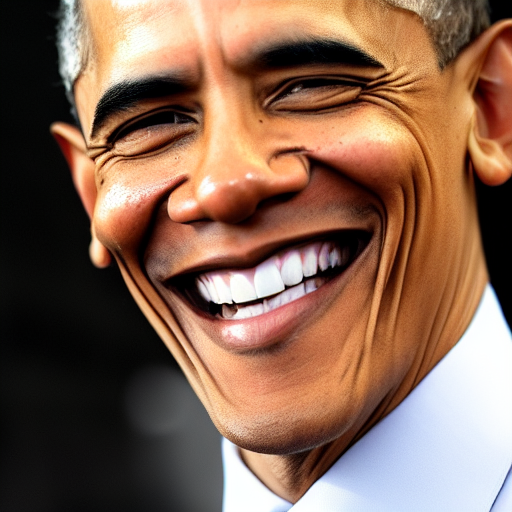

In [6]:
# make a copy of the text embedding
og_embedding = text_embedding.clone()

# feed into our model and see what it comes up with
img = generate_image_from_text_embedding(og_embedding)
print(img.size)
display(img)

In [ ]:
init_image = Image.open("../image_stocks/barack_obama.webp")
print(init_image.size)
# display(init_image)

In [8]:
init_image_latent = image2latent(init_image)

In [9]:
init_image_latent.dtype

torch.float32

In [ ]:
og_latent = init_image_latent.clone()

out_image = latents2images(og_latent)[0]
# display(out_image)

In [11]:
import torch.optim as optim

# Define learning rate and number of iterations
lr = 2e-3
it = 1000

# Initialize the optimizer for updating the embedding
opt = optim.Adam(
    [text_embedding],  # only optimise the embedding
    lr=lr,
)

# Define the loss criterion
criteria = torch.nn.MSELoss()

# Initialize a list to store the loss history
history = []

# Create a progress bar
progress = tqdm(range(it))
progress.set_description("steps")

diffusion_scheduler.set_timesteps(1000) # reset

# Prepare an accelerator to help with the training
accelerator = Accelerator(
    gradient_accumulation_steps=1,
    mixed_precision="fp16",
)
if accelerator.is_main_process:
    accelerator.init_trackers(
        "imagic",
        config={
            "embedding_learning_rate": lr,
            "text_embedding_optimization_steps": it,
        },
    )

  0%|          | 0/1000 [00:00<?, ?it/s]

norm(opt - tgt) = 17.875164031982422


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

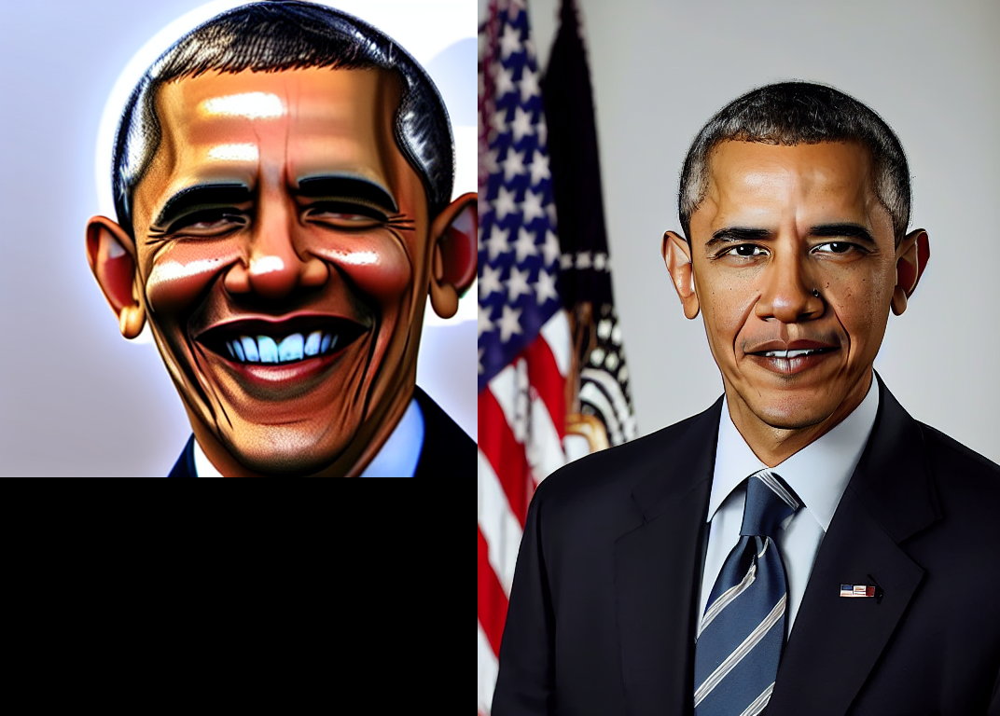

norm(opt - tgt) = 33.07547378540039


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

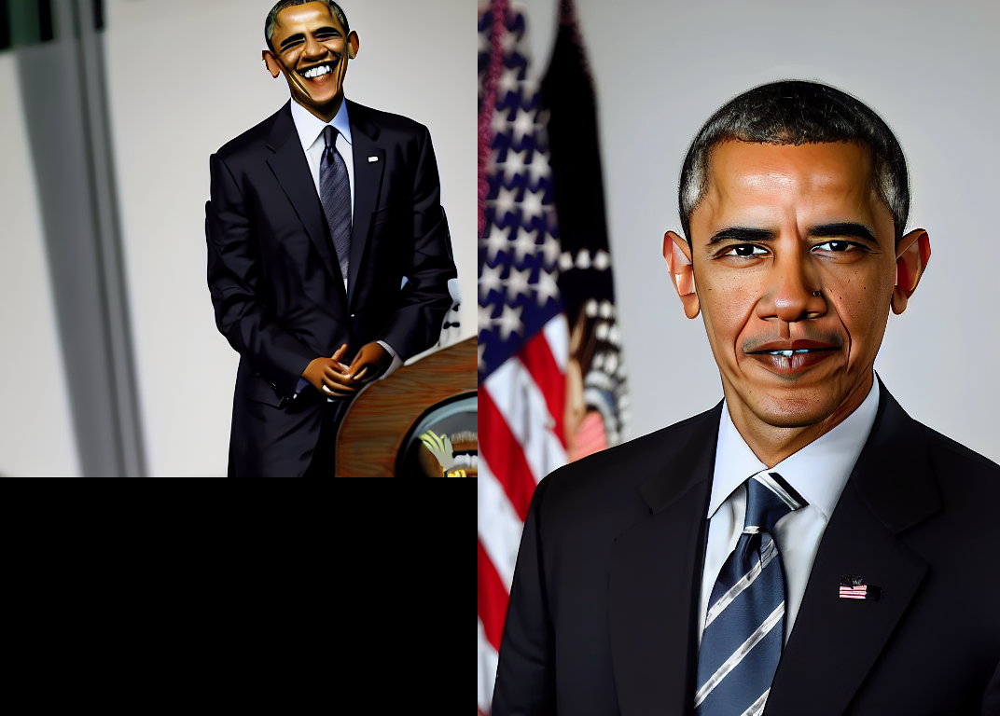

norm(opt - tgt) = 47.81079864501953


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

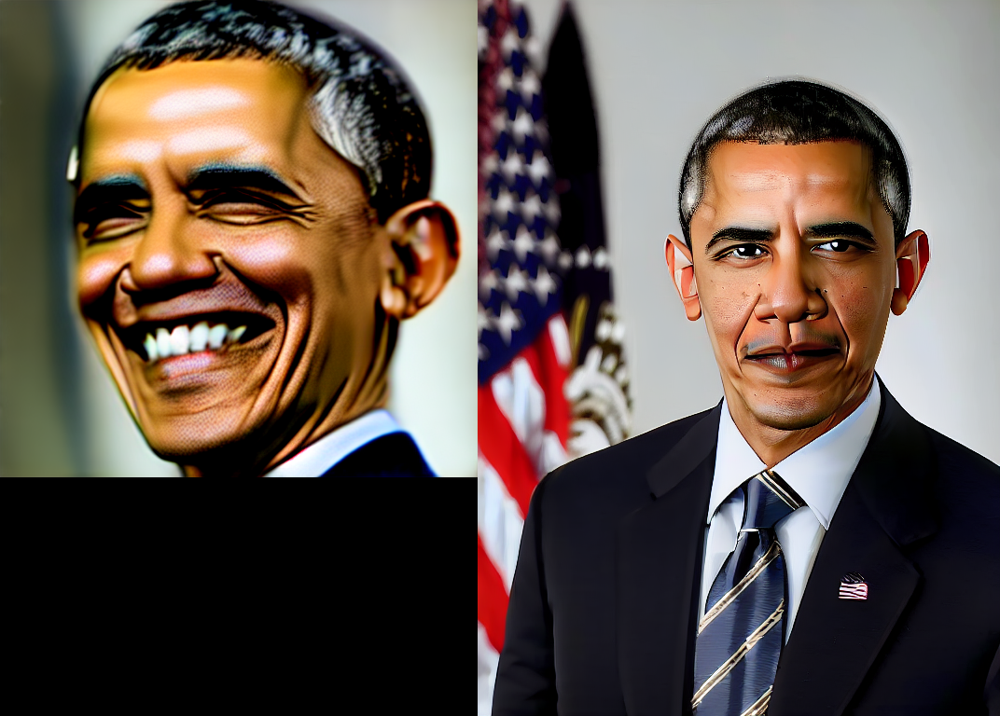

norm(opt - tgt) = 62.12636184692383


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

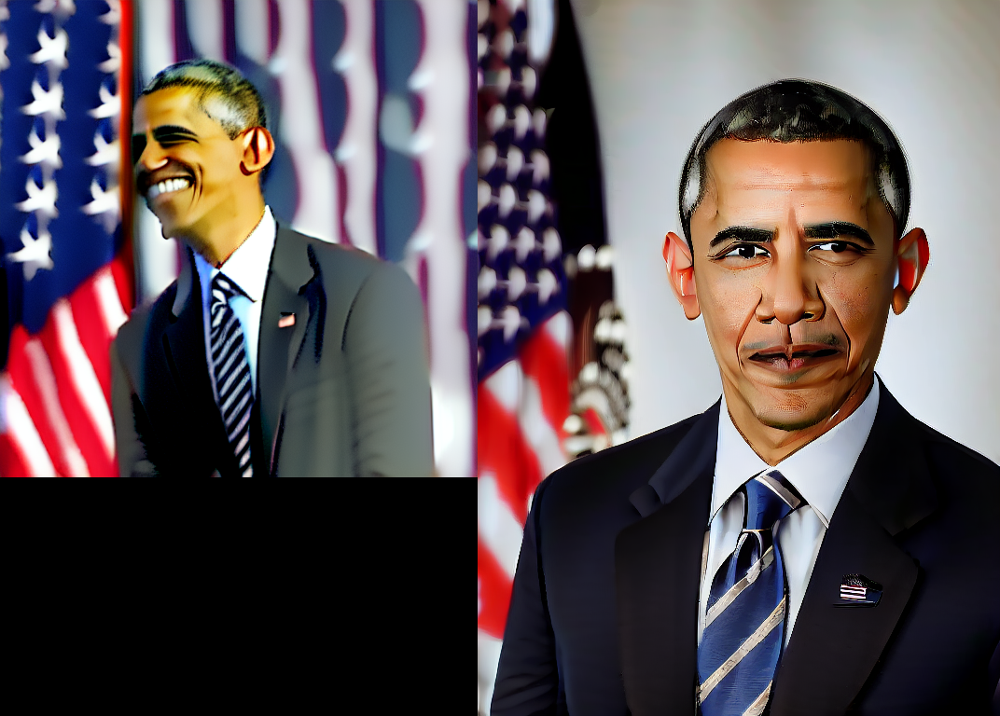

norm(opt - tgt) = 73.85953521728516


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

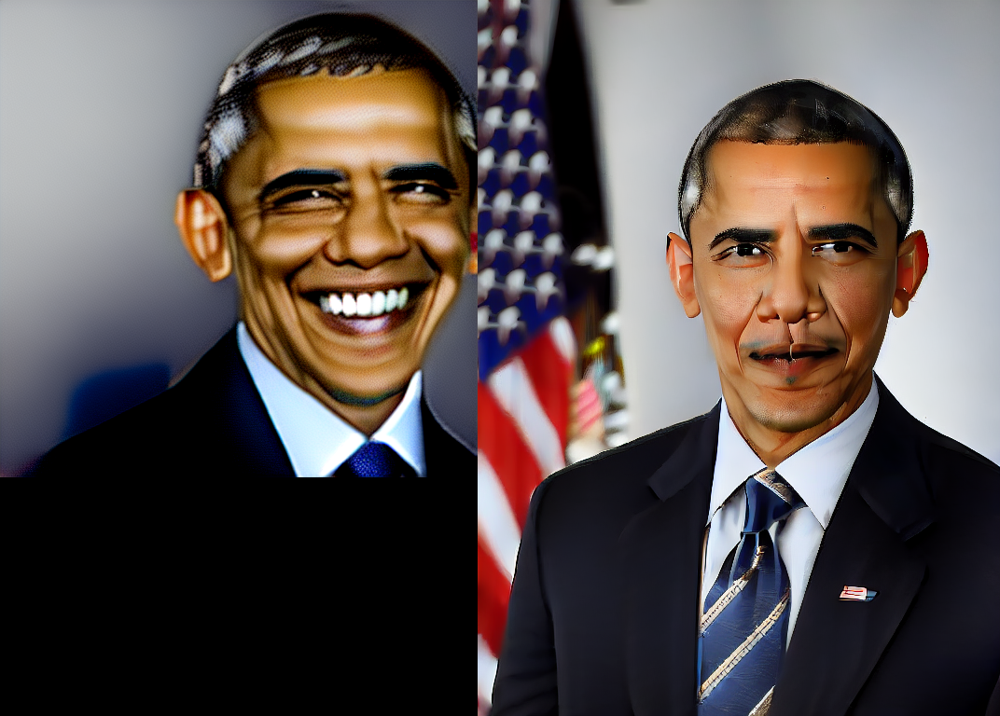

norm(opt - tgt) = 87.68096160888672


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

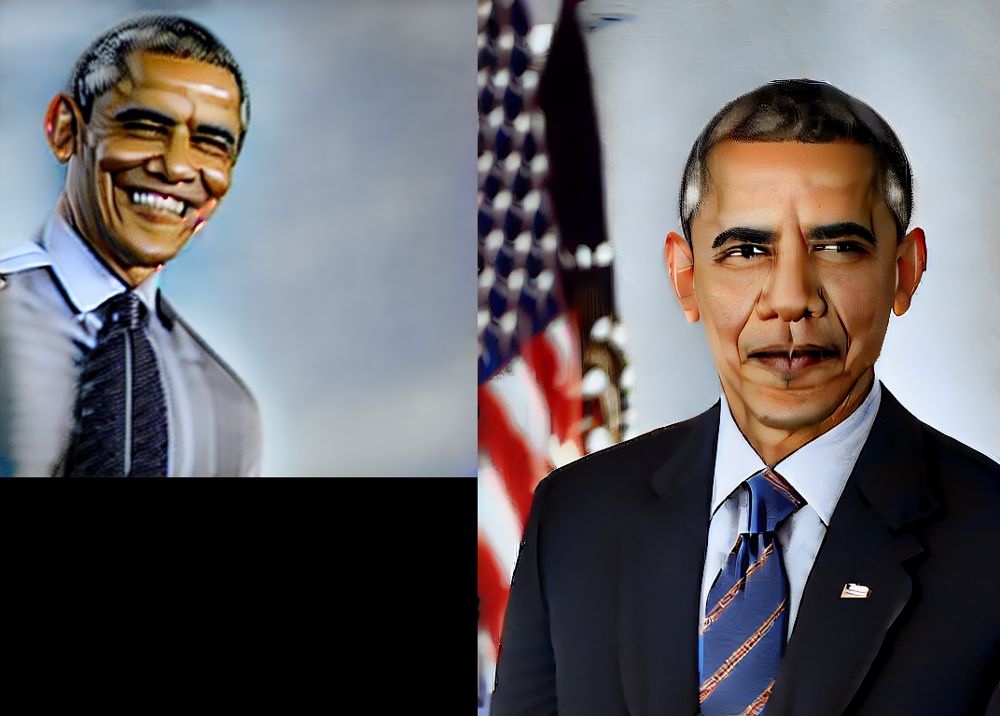

norm(opt - tgt) = 99.40479278564453


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

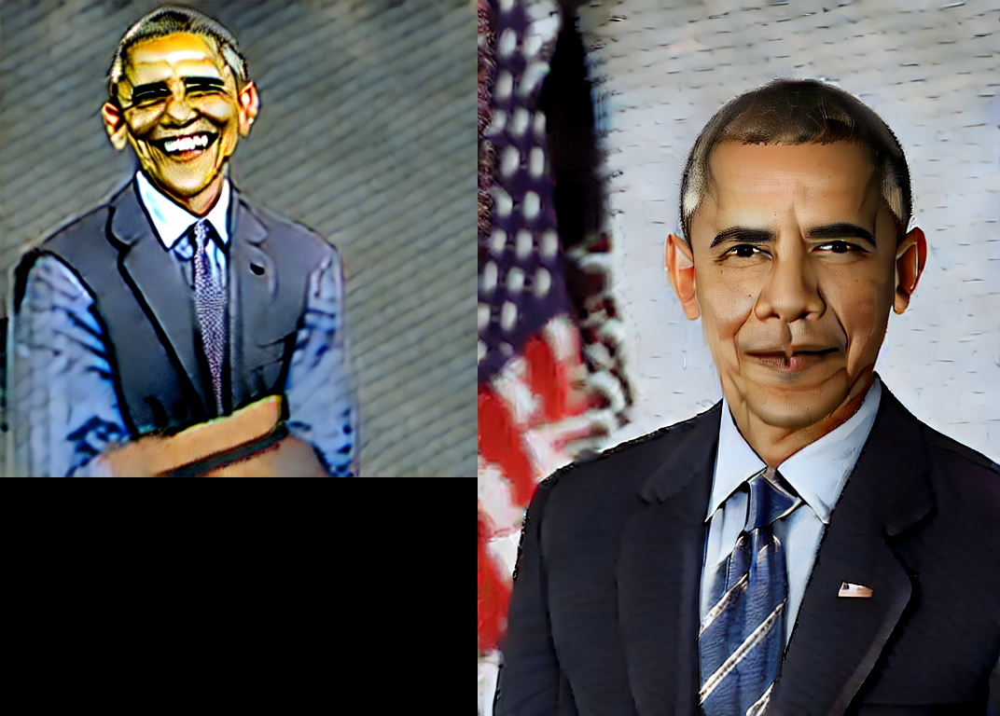

norm(opt - tgt) = 107.19630432128906


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

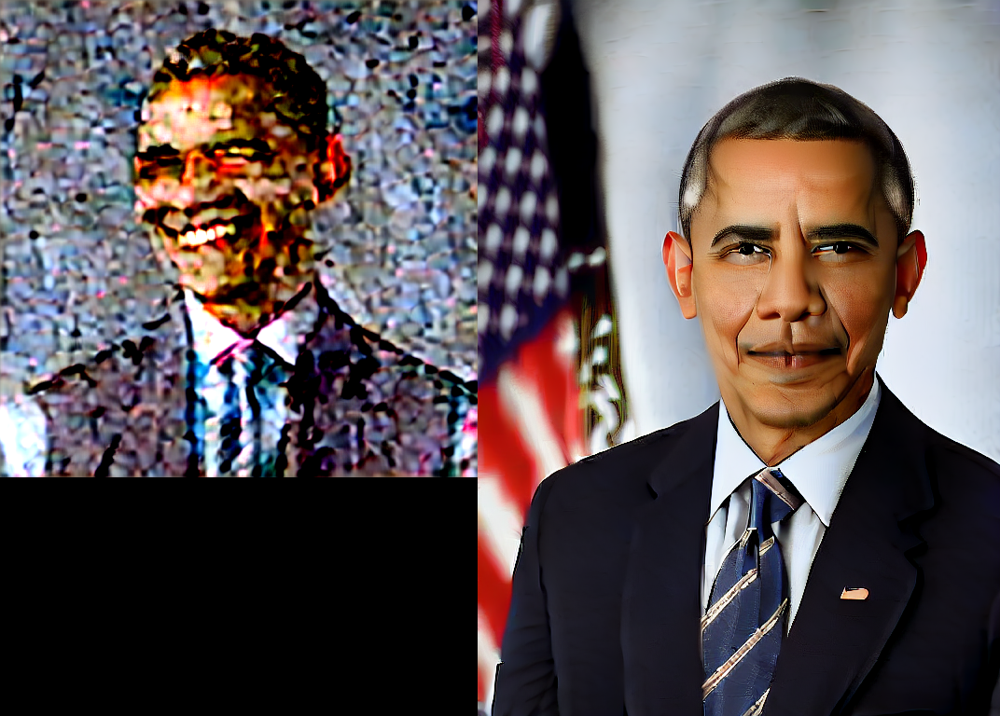

norm(opt - tgt) = 114.04849243164062


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

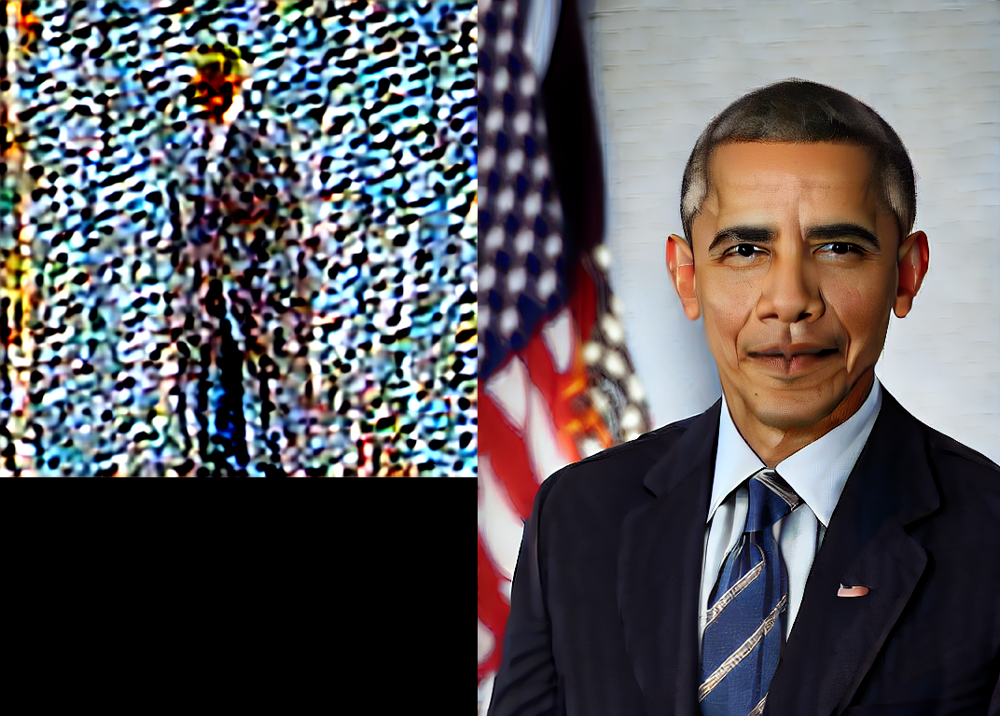

norm(opt - tgt) = 122.68274688720703


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

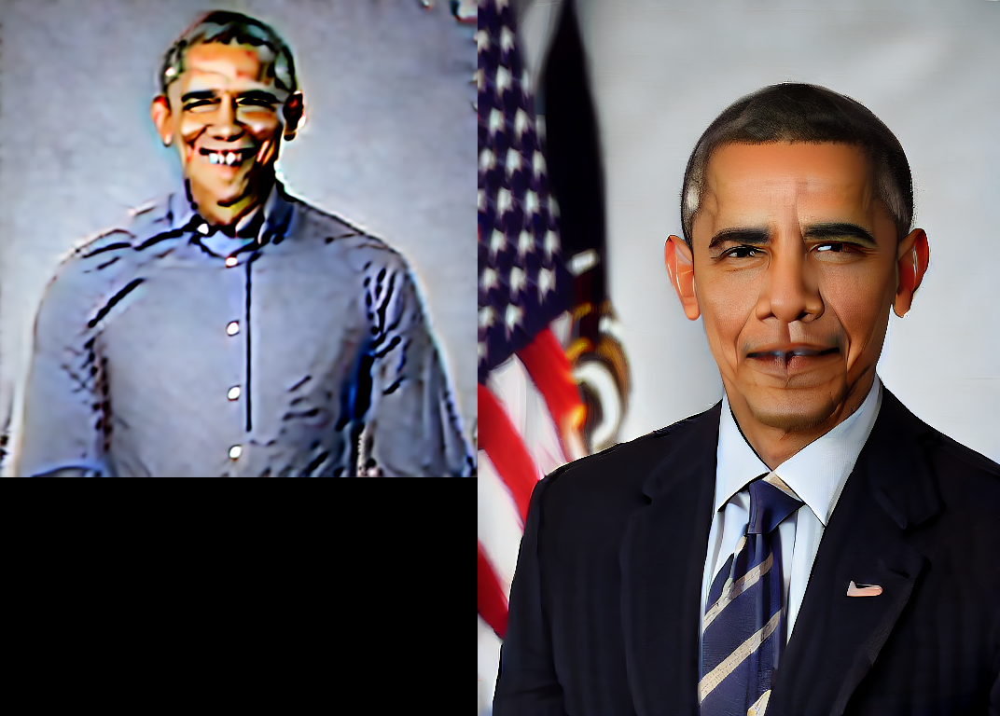

In [12]:
# Perform the training
for _ in progress:
    with accelerator.accumulate(text_embedding):
        noise = torch.randn_like(init_image_latent).to(device)
        timesteps = torch.randint(1000, (1,), device=device)

        noisy_latent = diffusion_scheduler.add_noise(init_image_latent, noise, timesteps=timesteps)

        noise_pred = unet(noisy_latent, timesteps, text_embedding).sample

        loss = criteria(noise_pred, noise)
        accelerator.backward(loss)

        opt.step()
        opt.zero_grad()
    
    if accelerator.sync_gradients:
        # Checks if the accelerator has performed an optimization step behind the scenes
        progress.update(1)
    
    progress.set_postfix({"loss": loss.item()})
    
    if ((_+1) % 100) == 0:
        with torch.no_grad():
            print(f"norm(opt - tgt) = {torch.norm(text_embedding - og_embedding)}")
            img_from_scratch = generate_image_from_text_embedding(text_embedding)
            img_from_init = generate_image_from_text_embedding(
                text_embedding,
                height = 768,
                width = 564,
                init = init_image_latent
            )
            imgs = [img_from_scratch, img_from_init]
            display(horizontal_frame(imgs))

accelerator.wait_for_everyone()

  0%|          | 0/20 [00:00<?, ?it/s]

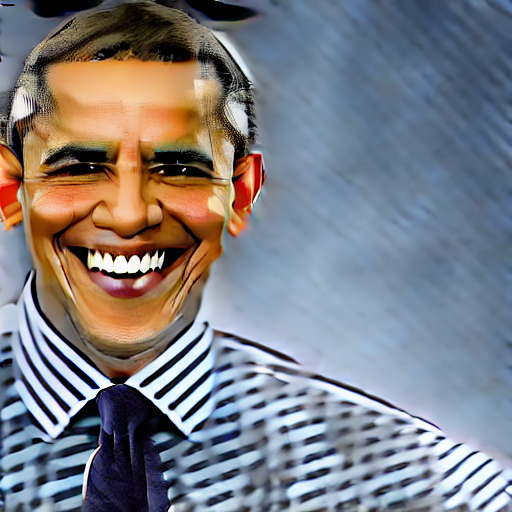

In [13]:
img = generate_image_from_text_embedding(text_embedding)
display(img)

In [14]:
text_embedding.requires_grad_(False) # fix the text embedding

lr = 5e-7
it = 1500
alpha = 0.8

unet.requires_grad_(True)
unet.train()
opt = optim.Adam(
    unet.parameters(),  # optimise unet parameters
    lr=lr,
)
criteria = torch.nn.MSELoss()

diffusion_scheduler.set_timesteps(1000) # reset

  0%|          | 0/1500 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

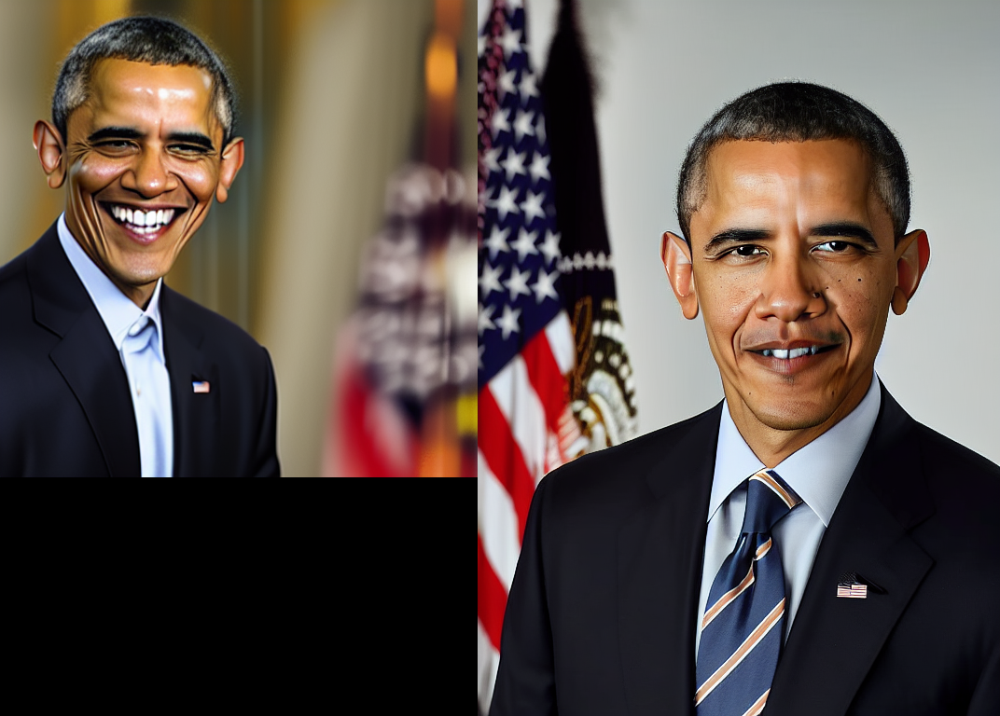

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

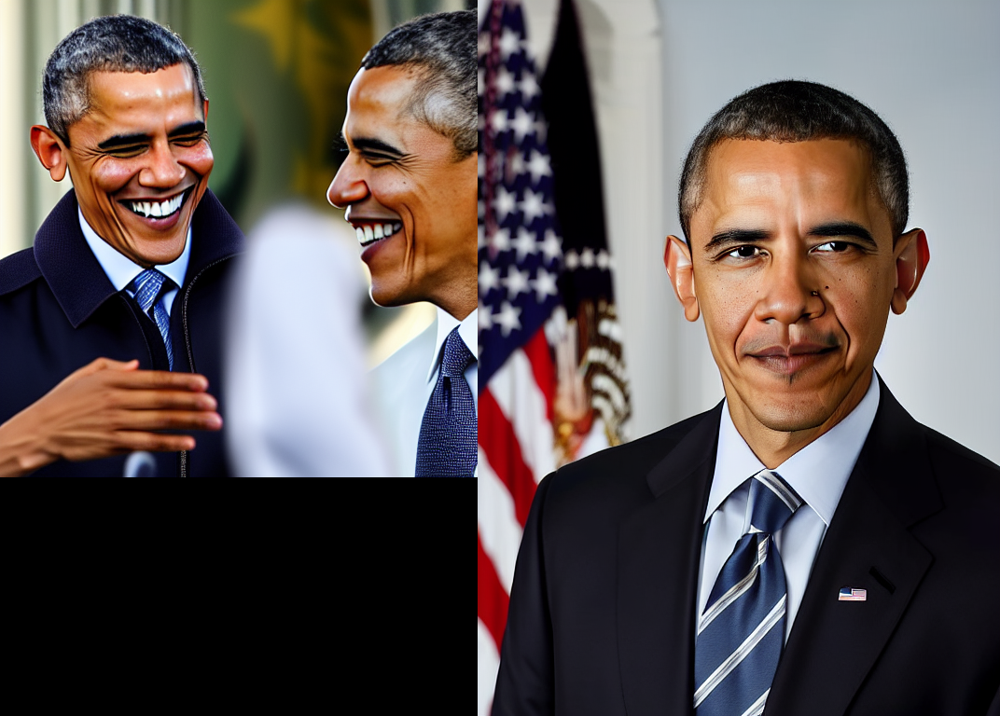

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

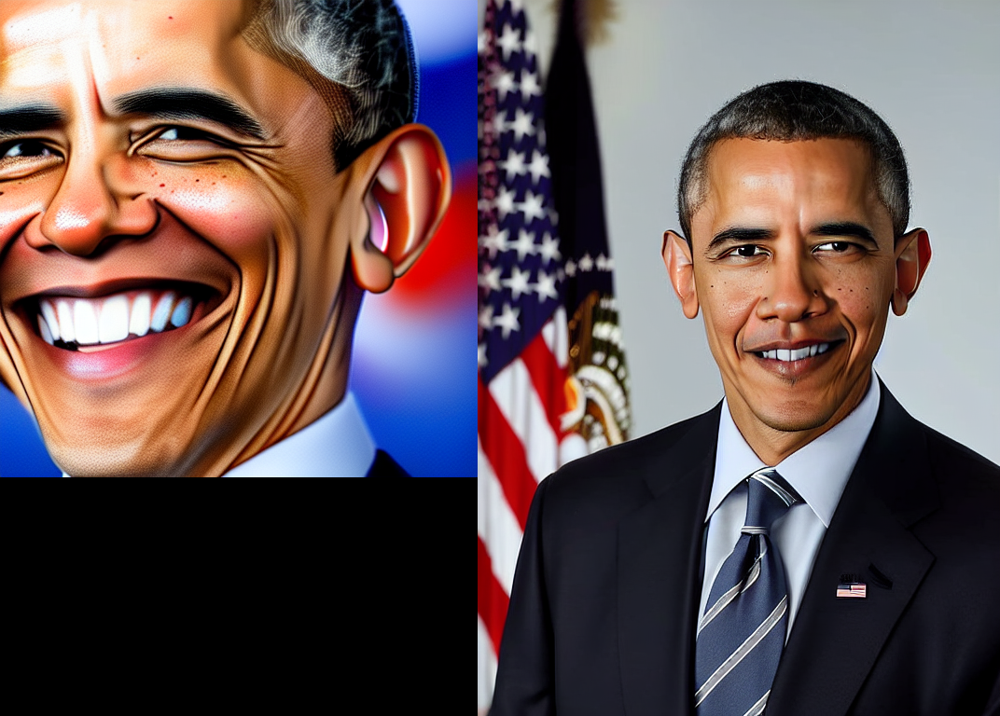

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

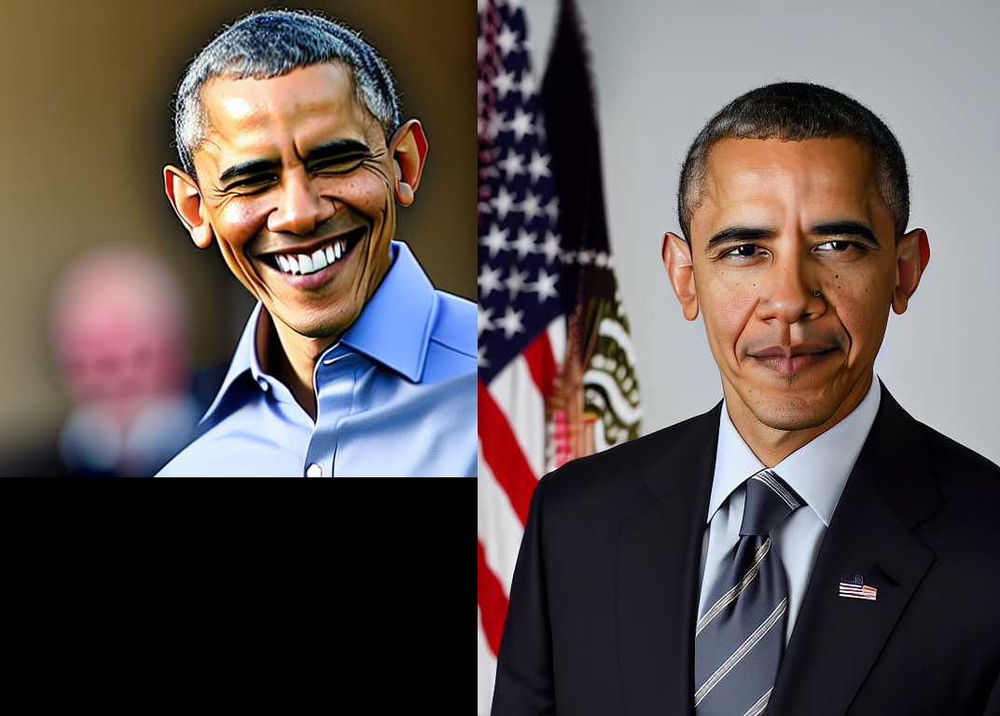

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

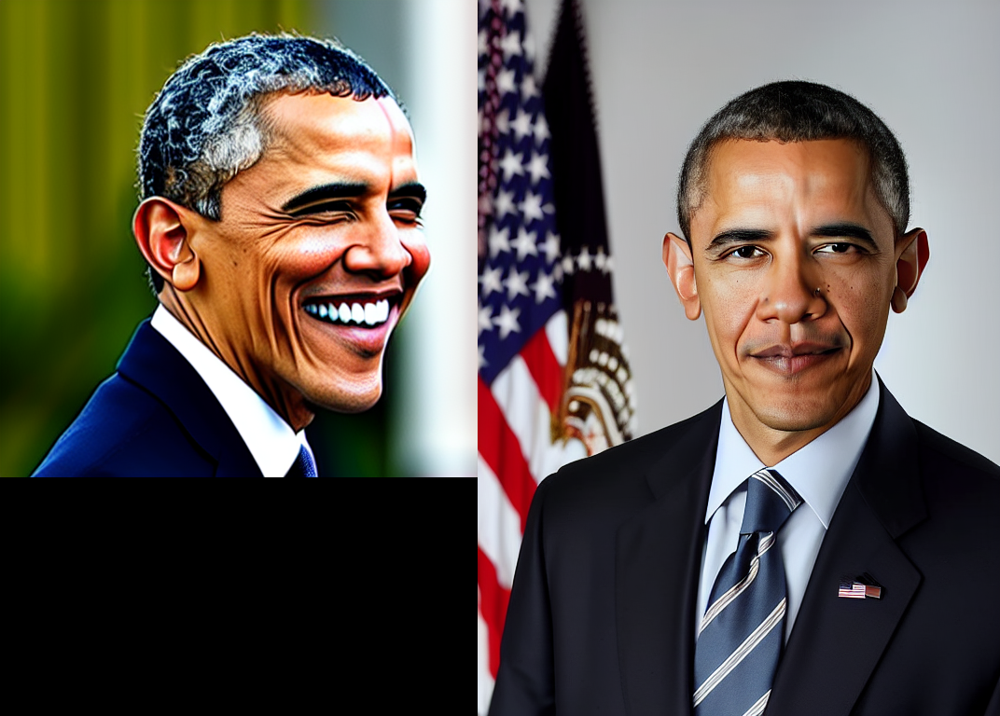

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

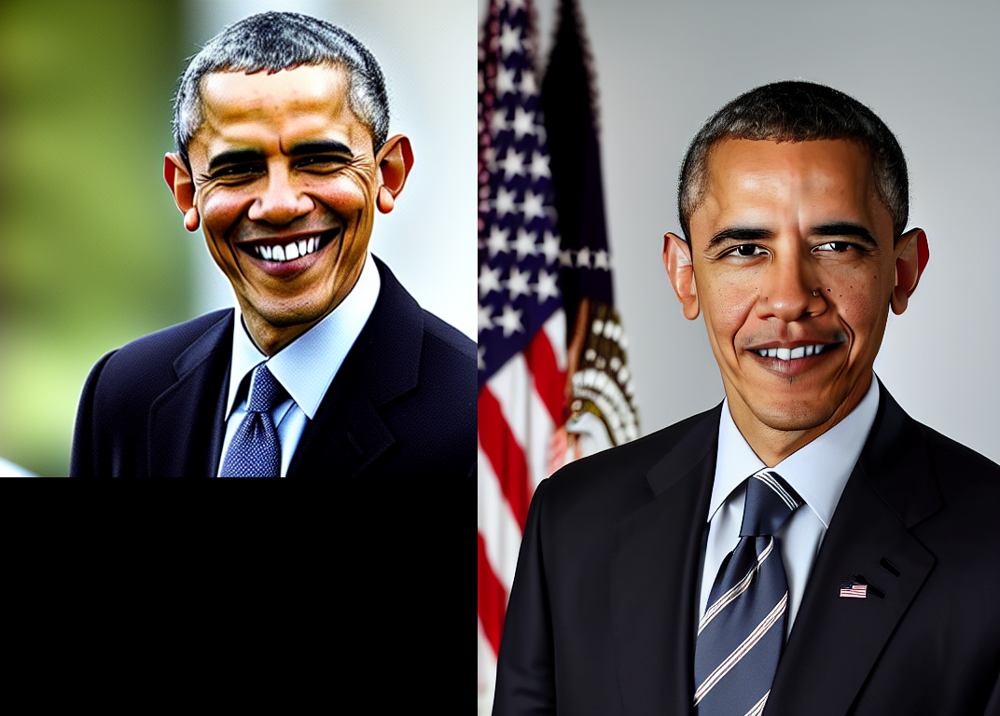

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

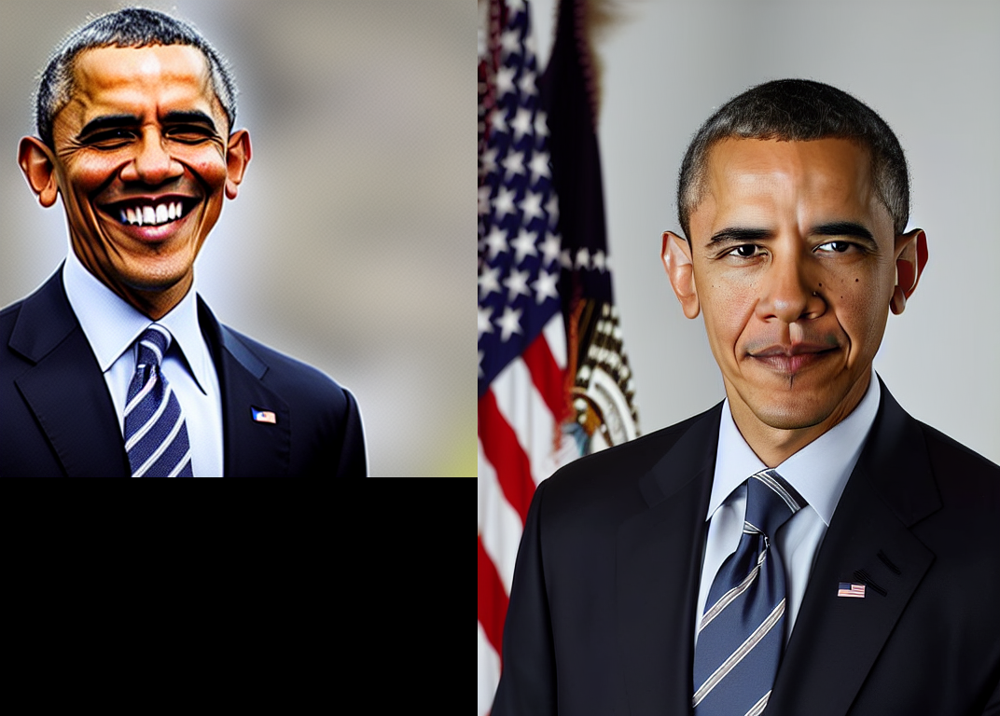

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

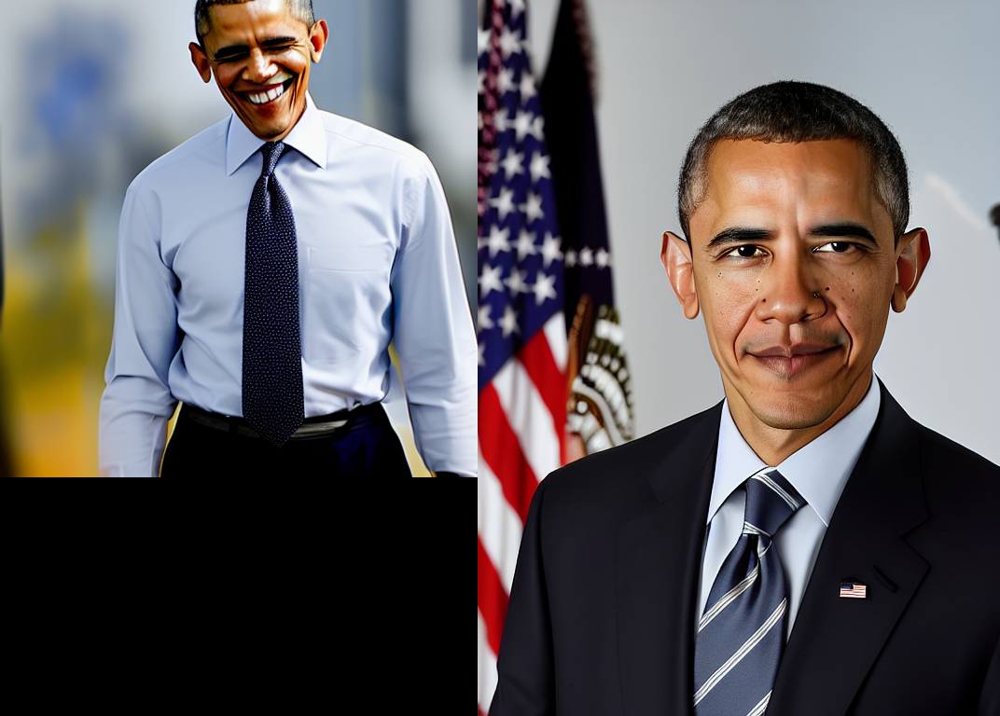

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

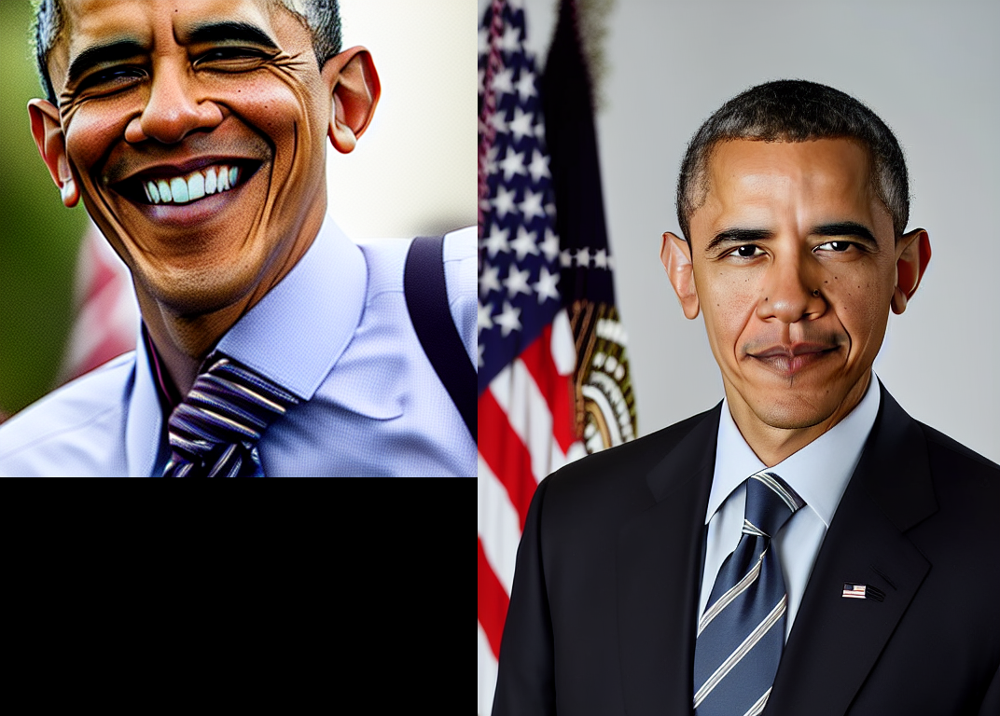

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

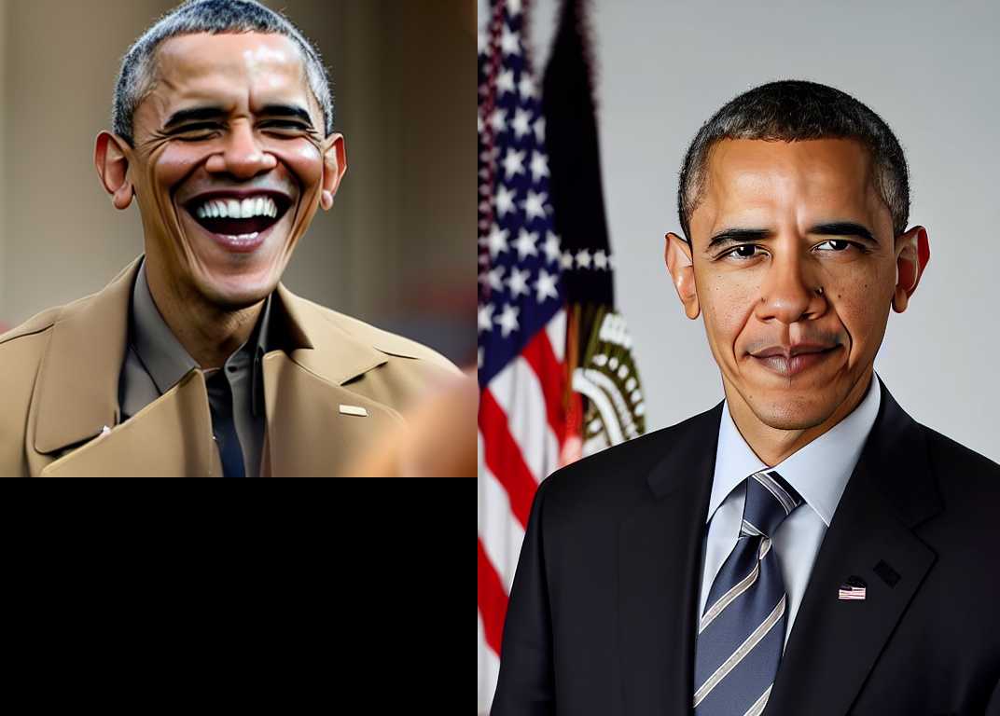

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

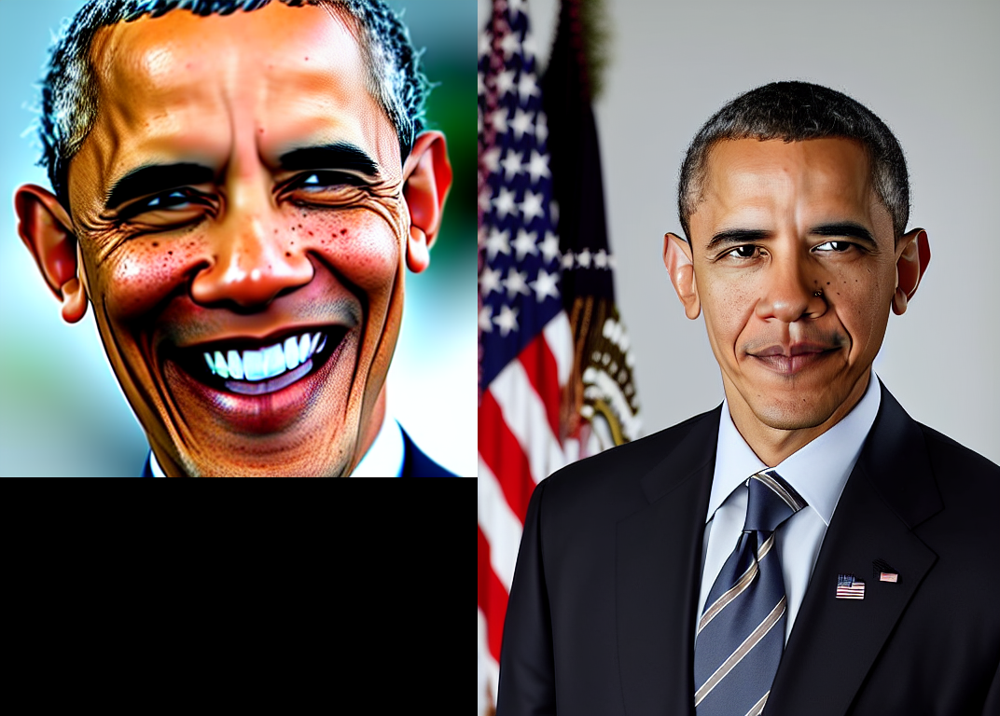

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

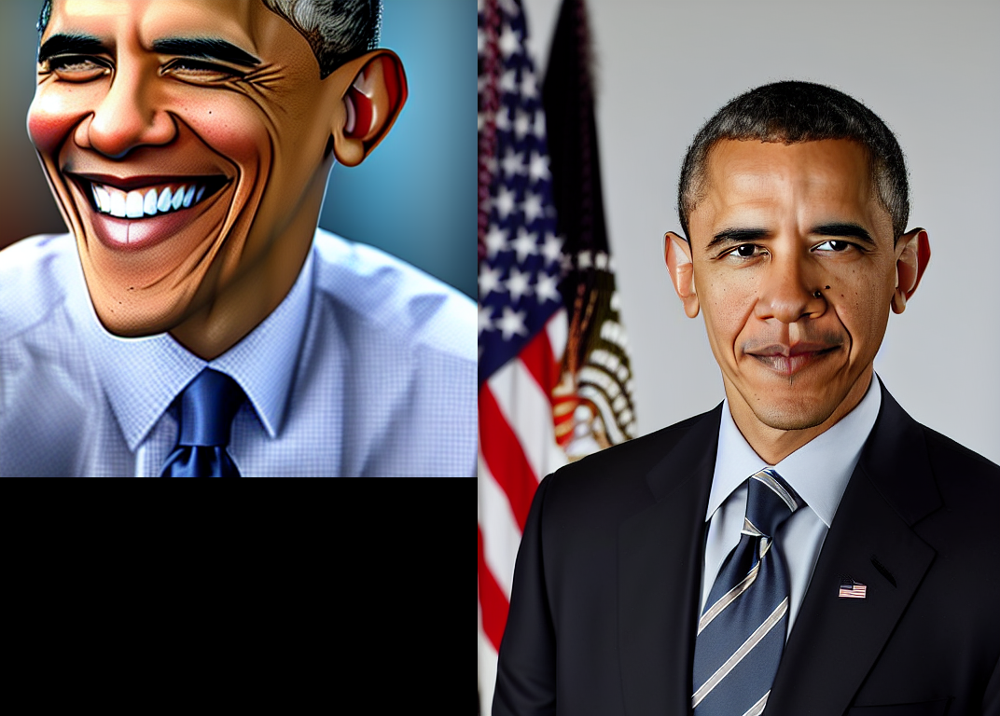

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

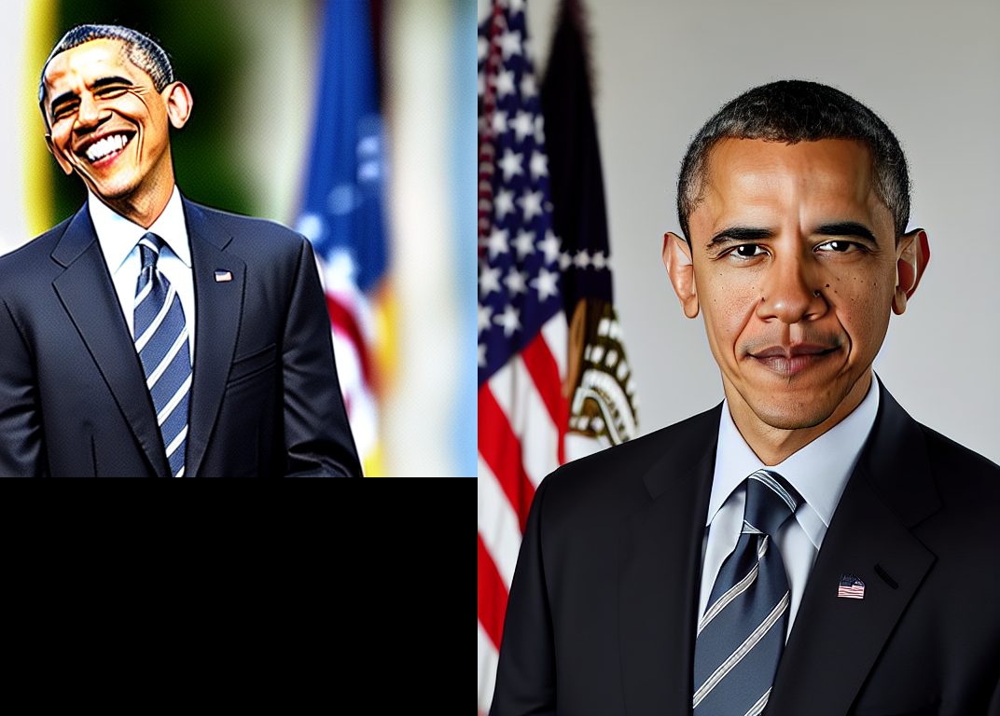

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

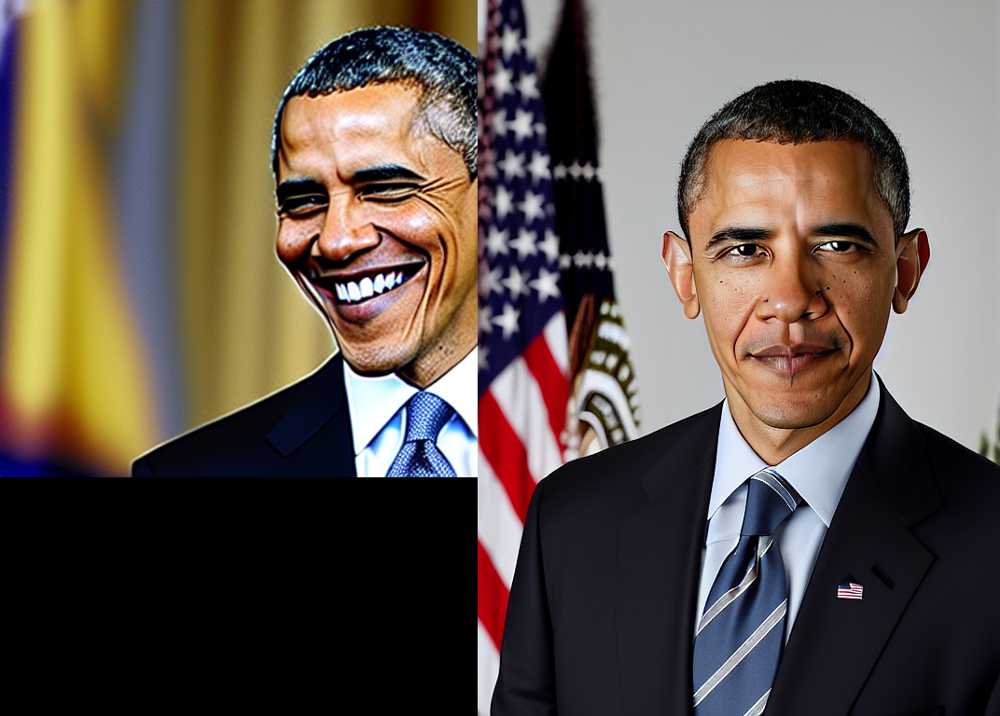

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

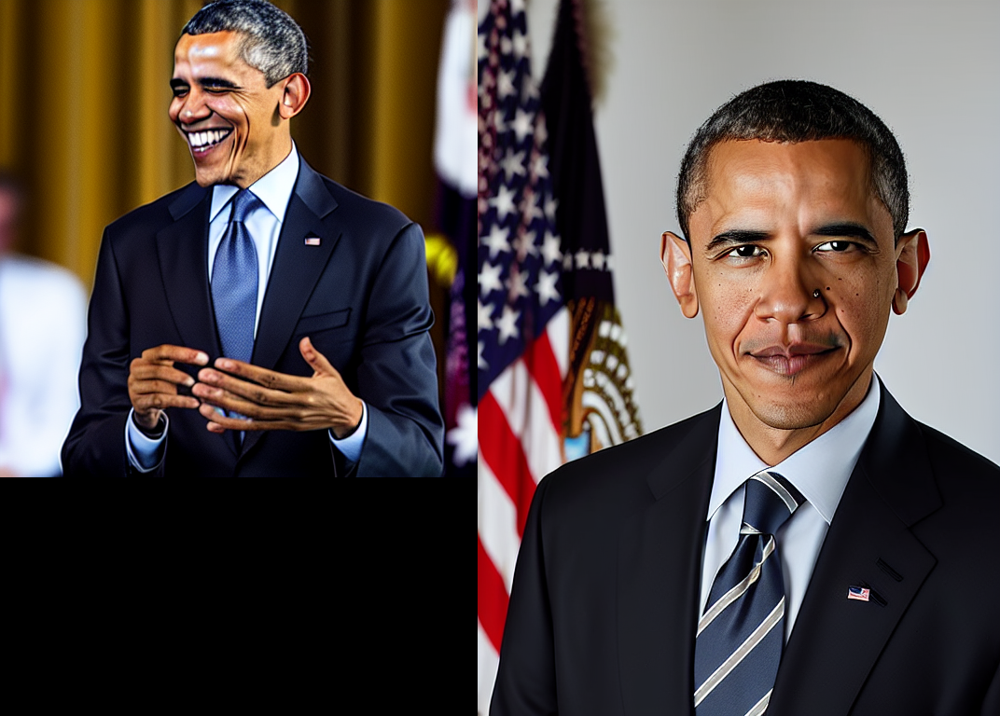

In [15]:
progress = tqdm(range(it))
for _ in progress:
    with accelerator.accumulate(unet.parameters()):
        noise = torch.randn_like(init_image_latent).to(device)
        timesteps = torch.randint(1000, (1,), device=device)
        noisy_latent = diffusion_scheduler.add_noise(init_image_latent, noise, timesteps)

        noise_pred = unet(noisy_latent, timesteps, text_embedding).sample

        loss = criteria(noise_pred, noise)
        accelerator.backward(loss)

        opt.step()
        opt.zero_grad()
    
    if accelerator.sync_gradients:
        # Checks if the accelerator has performed an optimization step behind the scenes
        progress.update(1)
    
    progress.set_postfix({"loss": loss.item()})

    if ((_+1) % 100) == 0:
        with torch.no_grad():
            new_emb = alpha*og_embedding + (1-alpha)*text_embedding
            img_from_scratch = generate_image_from_text_embedding(new_emb)
            img_from_init = generate_image_from_text_embedding(
                new_emb,
                height = 768,
                width = 564,
                init = init_image_latent
            )
            imgs = [img_from_scratch, img_from_init]
            display(horizontal_frame(imgs))

accelerator.wait_for_everyone()

In [ ]:
for alpha in (0.0, 0.5, 0.75, 1, 1.25):
    new_emb = alpha*og_embedding + (1-alpha)*text_embedding
    img = generate_image_from_text_embedding(new_emb, init=init_image_latent)
    # img.show()
    display(img)

In [ ]:
alpha = 1.2
generator = torch.Generator(device).manual_seed(0)
for _ in range(5):
    new_emb = alpha*og_embedding + (1-alpha)*text_embedding
    img = generate_image_from_text_embedding(new_emb, generator=generator, init=init_image_latent)
    # img.show()
    display(img)